In [1]:
import logging
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)
import palantir
import scanpy as sc
import scvelo as scv
import cellrank as cr
import scvi
import phate
import plotly.express as px
import numpy as np
from dash import Dash, dcc, html, Input, Output
scvi.settings.seed = 1995

import pandas as pd

import os
import sys
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"

# Plotting
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl

from copy import copy
reds = copy(mpl.cm.Reds)
reds.set_under("lightgray")

def matplotlib_to_plotly(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []

    for k in range(pl_entries):
        C = list(map(np.uint8, np.array(cmap(k * h)[:3]) * 255))
        pl_colorscale.append([k*h, 'rgb'+str((C[0], C[1], C[2]))])

    return pl_colorscale

plotly_reds = matplotlib_to_plotly(reds, 255)
plotly_reds[0] = [0.0, 'rgb(211, 211, 211)']
sc.set_figure_params(dpi=50,figsize=[6,4])

# Inline plotting
%matplotlib inline

project_directory = '/Cranio_Lab/Louk_Seton/mesenchyme_project_2023'
os.chdir(os.path.expanduser("~")+project_directory)

Global seed set to 1995


In [2]:
###custom functions
import time
from anndata import AnnData

from typing import TYPE_CHECKING, Literal, get_args
_Method = Literal["logreg", "t-test", "wilcoxon", "t-test_overestim_var"]
def plot_deg_embedding(
    adata: AnnData,
    method: _Method,
    groupby: str = 'leiden',
    key_added: str | None = None,
    cluster_name: str = '0',
    n_genes: int = 100,
    basis: str = 'X_scvi_MDE',
) -> AnnData | None:
    avail_methods = set(get_args(_Method))
    if method not in avail_methods:
        raise ValueError(f"Method must be one of {avail_methods}.")
    
    if key_added is None:
        key_added = "rank_genes_groups_"+method
    
    sc.set_figure_params(dpi=50,figsize=[6,4]) #small figures otherwise your notebook will crash
    sc.tl.rank_genes_groups(adata, groupby = groupby, method=method, key_added = key_added)
    genes = adata.uns[key_added]['names'][cluster_name][:n_genes].tolist()
    sc.pl.embedding(adata,
                    basis=basis,
                    color=[groupby]+genes,
                    frameon=False,
                    groups=cluster_name,
                    ncols=4,
                    cmap = reds,
                    vmin=0.1,
                   )

from anndata import AnnData
def scvi_anndata_test(
    adata: AnnData,
    batch_key: str = 'batch',
    continuous_covariate_keys: list = ['S_score','G2M_score'],
    layer: str='original_counts',
    n_latent: int = 20,
    n_layers: int = 1,
    max_epochs: int = 500,
    n_neighbors: int = 15,
    resolution: int = 1,
    key_added: str | None = None,
    leiden_key: str = 'leiden_scvi',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    if key_added is None:
        latent_key = "X_scvi"
        mde_key = "X_scvi_MDE"
    else:
        latent_key = key_added + "_scvi"
        mde_key = key_added + "_scvi_MDE"
    
    scvi.model.SCVI.setup_anndata(adata, #anndata object
                                  batch_key = batch_key, #categorical key for batch correction
                                  continuous_covariate_keys = continuous_covariate_keys,
                                                                #'total_counts',
                                                                #'pct_counts_mt',
                                                                #continuous key for cell cycle correction
                                  layer = layer) #layer with unmodified counts
    
    adata_model = scvi.model.SCVI(adata,
                                  n_latent = n_latent, #n_latent number of dimensions in latent space (think PCA but different)
                                  n_layers = n_layers, #n_layers number of layers in the neural network
                                 )
    
    print(adata_model.view_anndata_setup(adata))
    
    
    adata_model.train(
        max_epochs = max_epochs, #change how many runs it should train on
    )
    
    adata.obsm[latent_key] = adata_model.get_latent_representation()
    
    sc.pp.neighbors(adata,  #name of anndata object
                    n_neighbors = n_neighbors,
                    use_rep = latent_key,
                   )
    sc.tl.leiden(adata, #name of anndata object
                 resolution = resolution,
                 key_added = leiden_key
                )
    
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[latent_key])  
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

    
    
from anndata import AnnData
def harmony_integrate_pipe(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    batch_key: str = 'batch', #batch key
    rep_key: str = 'X_pca_harmony', #adjusted harmony pca
    mde_key: str = 'X_harmony_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_harmony',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    adata.X = adata.layers[layer].copy()
    try:
        del adata.uns['log1p']
    except:
        print('no log1p')
    
    sc.pp.normalize_total(adata, target_sum=target_sum)
    sc.pp.log1p(adata)
    sc.pp.scale(adata, max_value=max_value)
    sc.tl.pca(adata)
    sc.external.pp.harmony_integrate(adata,key = batch_key, adjusted_basis  = rep_key)
    sc.pp.neighbors(adata, use_rep = rep_key)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[rep_key])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

from anndata import AnnData
def harmony_regress_integrate_pipe(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    n_comps: int = 50, #comps of pca to calculate
    batch_key: str = 'batch', #batch key
    max_iter_harmony: int = 10,
    random_state: int = 999,
    rep_key: str = 'X_pca_harmony', #adjusted harmony pca
    mde_key: str = 'X_harmony_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_harmony',
    skip_preprocess: bool = False
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    if skip_preprocess is False:
        adata.X = adata.layers[layer].copy()
        try:
            del adata.uns['log1p']
        except:
            print('no log1p')
    
        sc.pp.normalize_total(adata, target_sum=target_sum)
        sc.pp.log1p(adata)
        sc.pp.scale(adata, max_value=max_value)
        if not 'phase' in adata.obs:
            print('cell cycle not scored, scoring now')
            score_cell_cycle_mouse(adata)
        print(str(time.time())+': Regressing cell cycle')
        sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
    print(str(time.time())+': PCA')
    sc.tl.pca(adata,n_comps = n_comps)
    sc.external.pp.harmony_integrate(adata,key = batch_key, adjusted_basis  = rep_key, max_iter_harmony = max_iter_harmony, random_state = random_state)
    sc.pp.neighbors(adata, use_rep = rep_key)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[rep_key])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

def score_cell_cycle_mouse(
    adata: AnnData,
) -> AnnData | None:
    cell_cycle_genes = ['Mcm5','Pcna','Tyms','Fen1','Mcm2','Mcm4','Rrm1','Ung','Gins2','Mcm6',
                    'Cdca7','Dtl','Prim1','Uhrf1','Cenpu','Hells','Rfc2','Rpa2','Nasp',
                    'Rad51ap1','Gmnn','Wdr76','Slbp','Ccne2','Ubr7','Pold3','Msh2','Atad2',
                    'Rad51','Rrm2','Cdc45','Cdc6','Exo1','Tipin','Dscc1','Blm','Casp8ap2',
                    'Usp1','Clspn','Pola1','Chaf1b','Brip1','E2f8','Hmgb2','Cdk1','Nusap1',
                    'Ube2c','Birc5','Tpx2','Top2a','Ndc80','Cks2','Nuf2','Cks1b','Mki67',
                    'Tmpo','Cenpf','Tacc3','Pimreg','Smc4','Ccnb2','Ckap2l','Ckap2','Aurkb',
                    'Bub1','Kif11','Anp32e','Tubb4b','Gtse1','Kif20b','Hjurp','Cdca3',
                    'Jpt1','Cdc20','Ttk','Cdc25c','Kif2c','Rangap1','Ncapd2','Dlgap5',
                    'Cdca2','Cdca8','Ect2','Kif23','Hmmr','Aurka','Psrc1','Anln','Lbr',
                    'Ckap5','Cenpe','Ctcf','Nek2','G2e3','Gas2l3','Cbx5','Cenpa',
                   ]
    s_genes = cell_cycle_genes[:43]
    g2m_genes = cell_cycle_genes[43:]
    cell_cycle_genes = s_genes + g2m_genes
    cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
    len(cell_cycle_genes)
    sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

def subset_by_cluster_and_gene( #shitty code to filter by an obs and var variable
    adata: AnnData,
    gene_name: str = 'Dlx5',
    layer: str = 'original_counts',
    expression_cutoff: int = 2,
    groupby: str = 'leiden',
    group: str = '0',
) -> AnnData | None:
    expression_index = adata[(adata[:,gene_name].layers[layer]>expression_cutoff),:].obs.index
    cluster_index = adata[(adata.obs[groupby]==group), : ].obs.index
    exclusion_index = cluster_index[cluster_index.isin(expression_index)]
    inclusion_index = adata.obs.index[~adata.obs.index.isin(exclusion_index)]
    adata = adata[inclusion_index,:].copy()
    return(adata)

def default_regress_cycle_to_mde(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    use_hvg_genes: bool = True, 
    n_top_genes: int = 3000, #number of top genes
    n_comps: int = 50, #comps of pca to calculate
    n_neighbors: int = 15,
    mde_key: str = 'X_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_default',
    skip_preprocess: bool = False
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    if skip_preprocess is False:
        adata.X = adata.layers[layer].copy()
        try:
            del adata.uns['log1p']
        except:
            print('no log1p')
    
        sc.pp.normalize_total(adata, target_sum=target_sum)
        sc.pp.log1p(adata)
        sc.pp.scale(adata, max_value=max_value)
        if not 'phase' in adata.obs:
            print('cell cycle not scored, scoring now')
            score_cell_cycle_mouse(adata)
        print(str(time.time())+': Regressing cell cycle')
        sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
    print(str(time.time())+': Highly Variable Genes')
    if use_hvg_genes is True:
        sc.pp.highly_variable_genes(adata, layer = layer, n_top_genes = n_top_genes, flavor = 'seurat_v3')
        
    print(str(time.time())+': PCA')
    sc.tl.pca(adata, n_comps=n_comps,use_highly_variable=True)
    print(str(time.time())+': Neighbors')
    sc.pp.neighbors(adata, n_neighbors = n_neighbors)
    print(str(time.time())+': MDE and UMAP')
    sc.tl.umap(adata),
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm['X_pca'])
    print(str(time.time())+': Leiden clustering')
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)
    sc.pl.embedding(adata,
                    basis='X_umap',
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

In [3]:
# adata = sc.read('anndata_objects/dataset_cleaned.h5ad')
# adata.layers['original_counts'] = adata.X.copy()

In [4]:
#adata.write('anndata_objects/dataset_cleaned.h5ad')

In [5]:
# adata_E14 = adata[adata.obs['stage']=='14'].copy()
# adata_E14.X = adata_E14.layers['original_counts'].copy()
# try:
#     del adata_E14.uns['log1p']
# except:
#   print("no log1p")

In [6]:
# sc.pp.normalize_total(adata_E14, target_sum=1e4)
# sc.pp.log1p(adata_E14)
# #sc.pp.scale(adata, max_value=10)
# #adata = batch_scale(adata)
# cell_cycle_genes = [x.strip() for x in open('regev_lab_cell_cycle_genes.txt')]
# s_genes = cell_cycle_genes[:43]
# g2m_genes = cell_cycle_genes[43:]
# cell_cycle_genes = s_genes + g2m_genes


# cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_E14.var_names]
# len(cell_cycle_genes)
# sc.tl.score_genes_cell_cycle(adata_E14, s_genes=s_genes, g2m_genes=g2m_genes)

In [7]:
# scvi.model.SCVI.setup_anndata(adata_E14, #anndata object
#                               batch_key = 'batch', #categorical key for batch correction
#                               continuous_covariate_keys = ['S_score', 'G2M_score',
#                                                            #'total_counts',
#                                                            #'pct_counts_mt',
#                                                           ], #continuous key for cell cycle correction
#                               layer = 'original_counts') #layer with unmodified counts
# adata_E14_model = scvi.model.SCVI(adata_E14,
#                                   n_latent = 40, 
#                                   #n_layers = 2,
#                                  ) #n_latent number of dimensions in latent space (think PCA but different)
#                                                                 #n_layers number of layers in the neural network
# adata_E14_model.view_anndata_setup(adata_E14) #view model configuration
# adata_E14_model.train(
#     max_epochs = 500
# ) #change how many runs it should train on
# #latent space parameters, layers and epochs affect the final representation. They should be tuned to get a desired representation.
# #make them too high and things will overfit, too low and things will underfit
# adata_E14.obsm['X_scvi'] = adata_E14_model.get_latent_representation() #add latent space to anndata object 

# #calculate neighbors using scvi latent space instead of a pca
# sc.pp.neighbors(adata_E14,  #name of anndata object
#                 use_rep = 'X_scvi')
# #clustering
# #key added variable is the name of the column that is added
# #if empty it will overwrite the 'leiden' column
# sc.tl.leiden(adata_E14, #name of anndata object
#              resolution = 1)
# adata_E14.obsm['X_scvi_MDE'] = scvi.model.utils.mde(adata_E14.obsm['X_scvi'])

#adata_E14.write('anndata_objects/adata_E14_integrated.h5ad')
adata_E14 = sc.read('anndata_objects/adata_E14_integrated.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


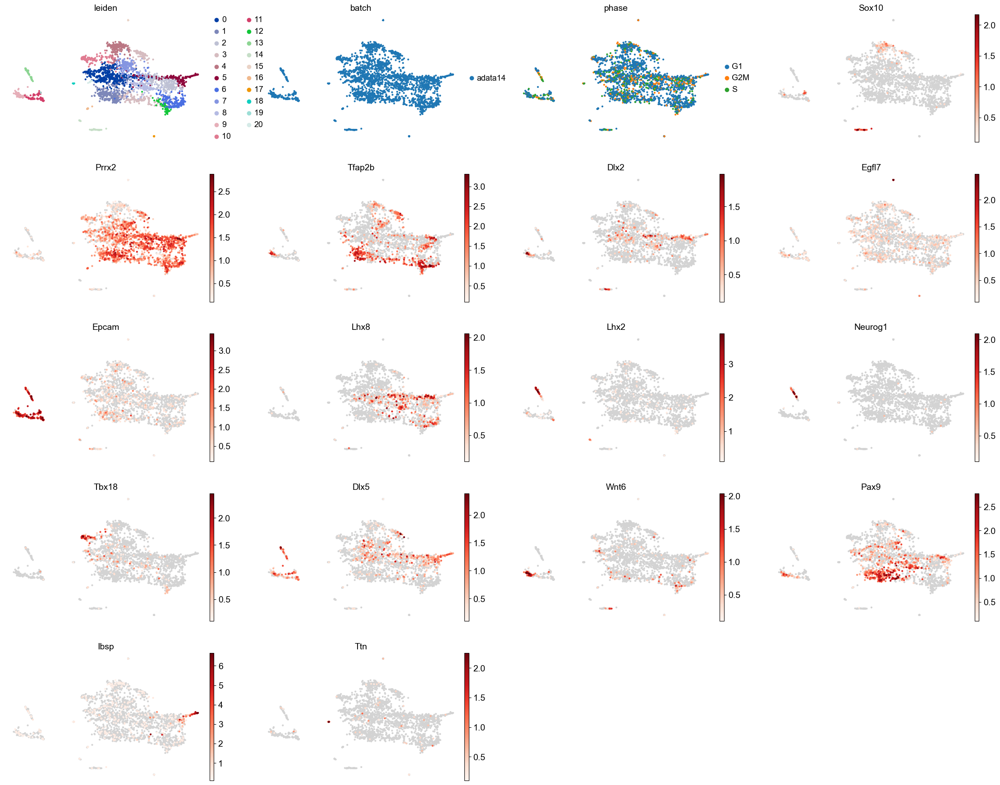

In [39]:
#keep cluster 0,1,2,3,4,6,7,11 for ectomesen, have to filter some more after
sc.set_figure_params(dpi=50,figsize=[6,4])

sc.pl.embedding(
    adata_E14,
    basis='X_scvi_MDE',
    color=['leiden','batch','phase','Sox10','Prrx2','Tfap2b','Dlx2',
           'Egfl7', #Endothelial
           'Epcam', #ectoderm
           'Lhx8', #brain stuff
           'Lhx2', #prospective telencephalon
           'Neurog1',
           'Tbx18', #mesoderm
           'Dlx5', 'Wnt6', #placode
           'Pax9', #this stuff is def not ectomesen
           'Ibsp',
           'Ttn', #muscle
          ],
    #groups=['3','5','7','9'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


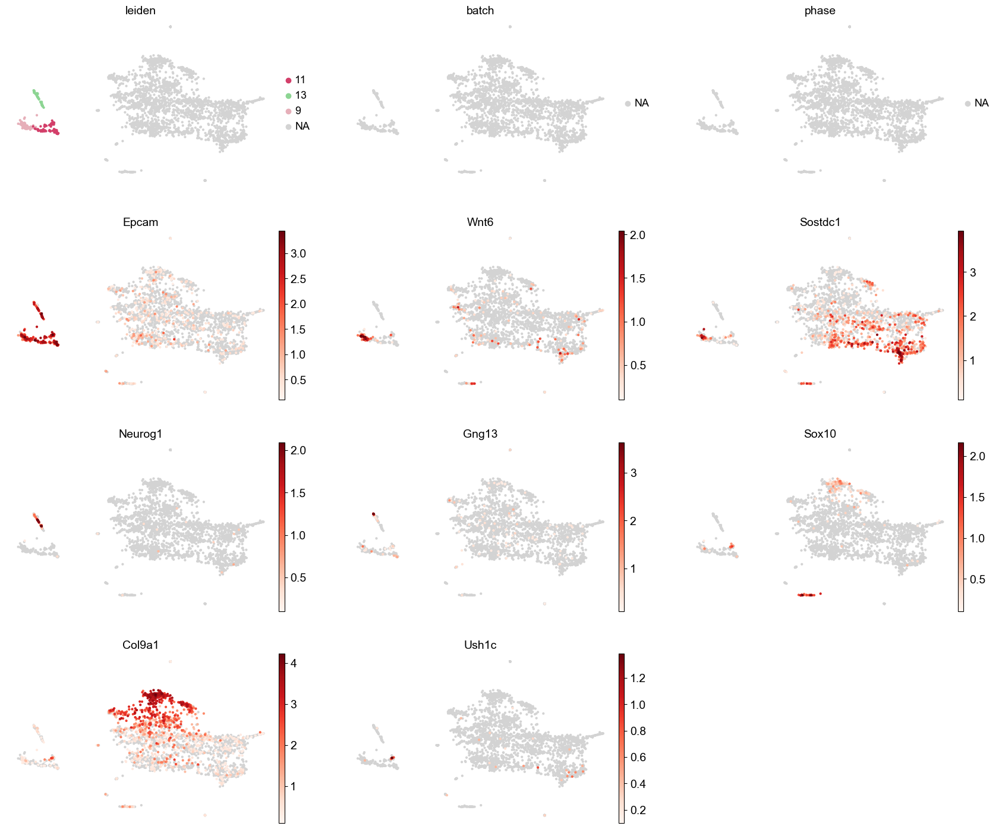

In [24]:
sc.pl.embedding(
    adata_E14,
    basis='X_scvi_MDE',
    color=['leiden','batch','phase','Epcam','Wnt6','Sostdc1','Neurog1','Gng13','Sox10','Col9a1','Ush1c',],
    groups=['9','11','13',],
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
)

1709499727.9063: Regressing cell cycle
1709499789.920137: Highly Variable Genes
1709499790.6803107: PCA
1709499790.7380216: Neighbors
1709499794.6103482: MDE and UMAP
1709499798.6390321: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


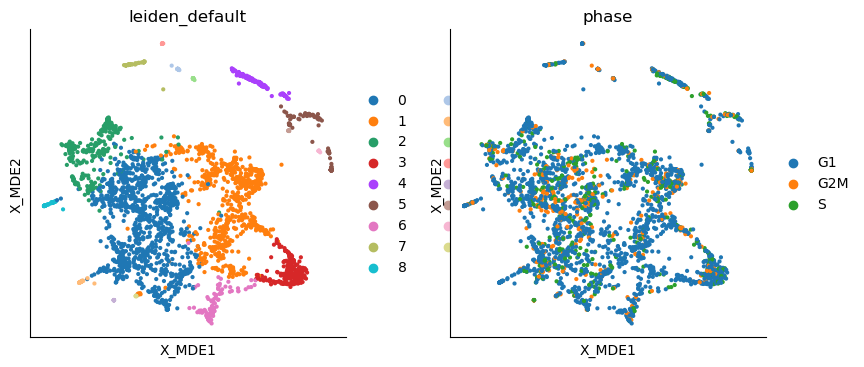

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


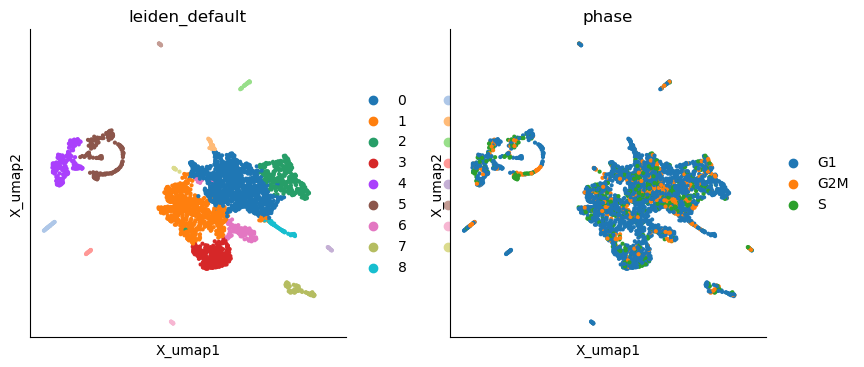

In [8]:
default_regress_cycle_to_mde(adata_E14, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = .2,n_top_genes = 2000)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


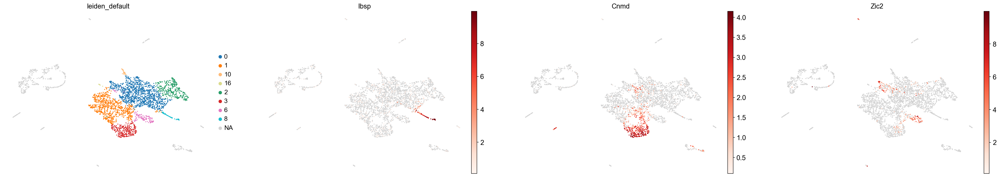

In [10]:
sc.set_figure_params(dpi=70,figsize=[8,6])

sc.pl.embedding(
    adata_E14,
    size=15,
    basis='X_umap',
    color=['leiden_default','Ibsp','Cnmd','Zic2',],
    #groups=['23','20'],
    groups=['0','1','2','3','6','8','10','16',],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

In [11]:
adata_E14_mesen = adata_E14[adata_E14.obs['leiden_default'].isin(['0','1','2','3','6','8','10','16'])].copy()

1709499898.7861967: Regressing cell cycle
1709499929.8231926: Highly Variable Genes
1709499930.1336656: PCA
1709499930.2905645: Neighbors
1709499930.423614: MDE and UMAP
1709499933.6334984: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


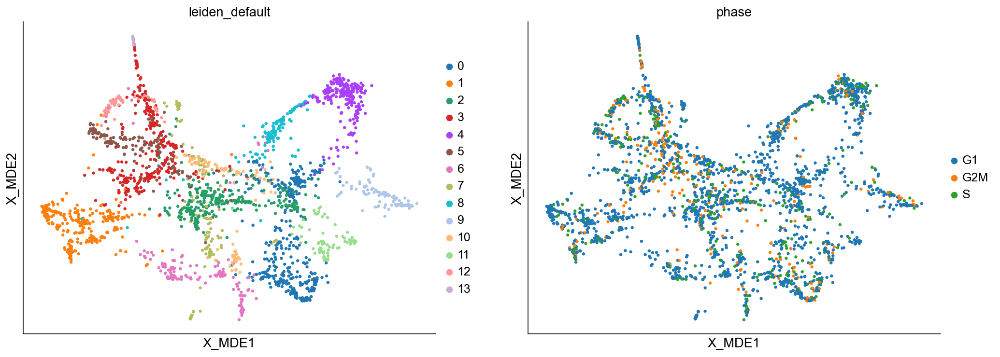

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


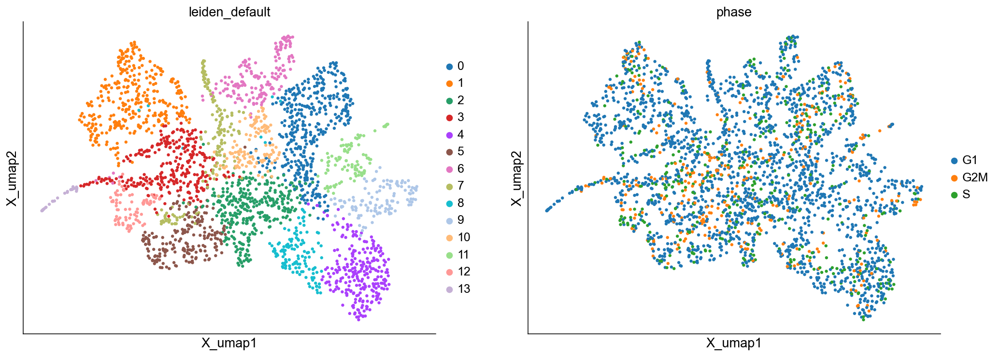

In [12]:
default_regress_cycle_to_mde(adata_E14_mesen, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = .5,n_top_genes = 2000)

In [ ]:
sc.set_figure_params(dpi=70,figsize=[8,6])

sc.pl.embedding(
    adata_E14_mesen,
    size=40,
    basis='X_umap',
    color=['leiden_default','Cnmd','Matn4','Col2a1','Col9a2','Sema3e','Wnt5a','Msx1','Wwp2','Mpz',
           'Ebf3','Sox18','Lef1','Gata3','Zic2','Fxyd5','Rgs5','Ebf2','Gas1',],
    #groups=['23','20'],
    groups=['0','1','3','4','5','6','7','8','10','12','13'],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

#Remove Zic2 and Rgs5 clusters, 11 and 9
    #Fxyd5 and Col18a1/2
    Positional-programs-in-facial-variability
#Remove Ebf2/Gas2 Hoxa2 cluster, it's hox+ and very posterior

#Foxl2/Cdh6 likely periocular

#Sim1 En1 Hmx1 likely dorsal nose

#Palatal shelf
    #Shox2, Meox2 and Meis2

#Bone
    #Ibsp
    
#Osteogenic mesenchyme
    #Runx2, Sp7, Ibsp-
        #mystery sub, Pitx2+ Sp7-

#Lrriq+Pappa In upper lip still

#Dental still exists
    #Tfap2b Rgs5 -> Molar; Sfrp4 -> incisor

#Wnt5a+ Gata2+ Foxd2+ Gsc- Nostril

#Gsc+ clusters -> Nasal cavity
    #Tfap2b- Ventral
    #Tfap2b+ Dorsal

#Gata3, Dkk1, Flrt2 Vomer related, medionasal derivatives

#Wnt5a Msx1 Matn4 Wwp2 Col2a1 + Nasal capsule cartilage
#Other cartilage is Nasal Septum



In [21]:
adata_E14_mesen_filt = adata_E14_mesen[adata_E14_mesen.obs['leiden_default'].isin(['0','1','3','4','5','6','7','8','10','12','13'])].copy()

In [22]:
#adata_E14_mesen_filt.write('anndata_objects/adata_E14_mesen_filt.h5ad')

In [3]:
adata_E14_mesen_filt = sc.read('anndata_objects/adata_E14_mesen_filt.h5ad')

In [ ]:
sc.tl.leiden(adata_E14_mesen_filt, resolution = 2, key_added = 'leiden_mesen_fine')
sc.tl.leiden(adata_E14_mesen_filt, resolution = 1.5, key_added = 'leiden_mesen_fine2')

In [88]:
adata_E14_mesen_filt.obs['E14_mesen_annotation_coarse'] = 'tmp' #create new column

adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '0'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Septum' #Col2a1/Matn4 Msx2-
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '1'].obs.index,'E14_mesen_annotation_coarse'] = 'Palatal Mesenchyme' #Meox2 + Asb4
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '2'].obs.index,'E14_mesen_annotation_coarse'] = 'Whisker Pad' #Twist2 Wnt5a Hey2 Lef1 Ebf3
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '3'].obs.index,'E14_mesen_annotation_coarse'] = 'Osteoblasts' #Alpl Sp7 Panx3
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '4'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Cavity - Anterior' #Msx1 Wnt5a+ lacks other markers
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '5'].obs.index,'E14_mesen_annotation_coarse'] = 'Periochondrium - Mmp9' #Mmp9
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '6'].obs.index,'E14_mesen_annotation_coarse'] = 'Osteogenic Mesenchyme - Pitx2' #Pitx2
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '7'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Cavity - Between' #Iigp1 !Sqor!
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '8'].obs.index,'E14_mesen_annotation_coarse'] = 'Foxl2 - Periocular' #Foxl2 Cdh6 Mfap5 Tmeff2
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '9'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Capsule - Anterior' #Wnt5a
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '10'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Cavity - Dorsal' #Tfap2b Emcn
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '11'].obs.index,'E14_mesen_annotation_coarse'] = 'Posteroventral Medionasal' #Gata3
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '12'].obs.index,'E14_mesen_annotation_coarse'] = 'Lip' #Pappa Lrriq1
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '13'].obs.index,'E14_mesen_annotation_coarse'] = 'Whisker Pad' # En1 Sim1
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '14'].obs.index,'E14_mesen_annotation_coarse'] = 'MxP - Pla2g7' #Dlx1/2 Pla2g7 Rmst
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '15'].obs.index,'E14_mesen_annotation_coarse'] = 'Dental Mesenchyme' #
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '16'].obs.index,'E14_mesen_annotation_coarse'] = 'Nasal Cavity - Anteroventral' #Gsc Mecom Col18a1 Nrg1 Dio3
adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'] == '17'].obs.index,'E14_mesen_annotation_coarse'] = 'Osteocytes' #Sost+ Dkk1


adata_E14_mesen_filt.obs.loc[adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen_fine'] == '24'].obs.index,'E14_mesen_annotation_coarse'] = 'Posteroventral Medionasal' #Dkk1 Gata3 Meis2


adata_E14_mesen_filt.obs['E14_mesen_annotation_coarse'] = adata_E14_mesen_filt.obs['E14_mesen_annotation_coarse'].astype('category')

adata_E14_mesen_filt.obs['E14_mesen_annotation_coarse'] = adata_E14_mesen_filt.obs['E14_mesen_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

1720683890.3191557: Regressing cell cycle
1720683909.8075042: Highly Variable Genes
1720683909.928773: PCA
1720683909.9611008: Neighbors
1720683909.9963083: MDE and UMAP
1720683912.0866854: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


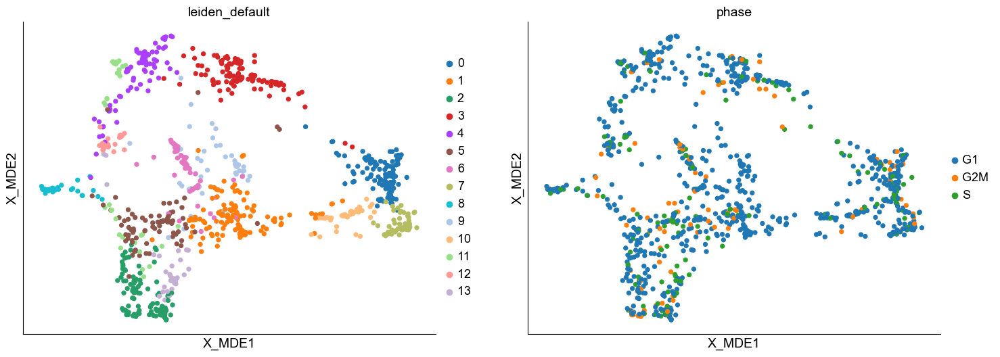

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


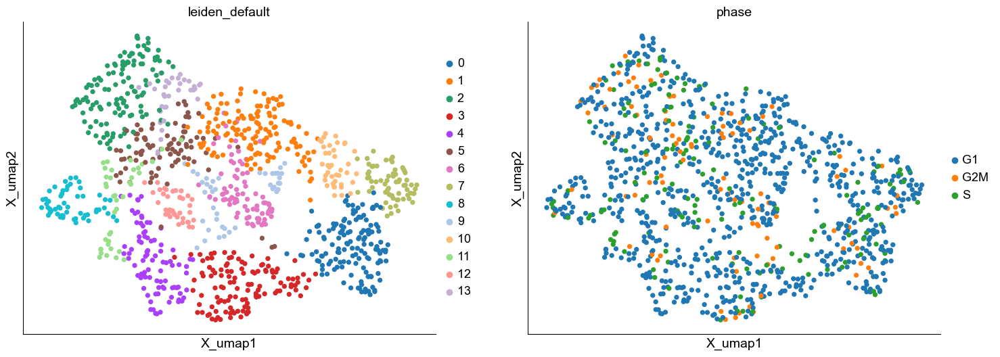

In [26]:
adata_E14_nasal = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_coarse'].isin(['2','3','4','5',])].copy()
default_regress_cycle_to_mde(adata_E14_nasal, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = 1,n_top_genes = 1500)
adata_E14_nasal.X = adata_E14_nasal.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E14_nasal, target_sum=1e4)
sc.pp.log1p(adata_E14_nasal)

In [27]:
sc.tl.leiden(adata_E14_nasal, #name of anndata object
              resolution = .8, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E14_nasal, #name of anndata object
              resolution = 1.6, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


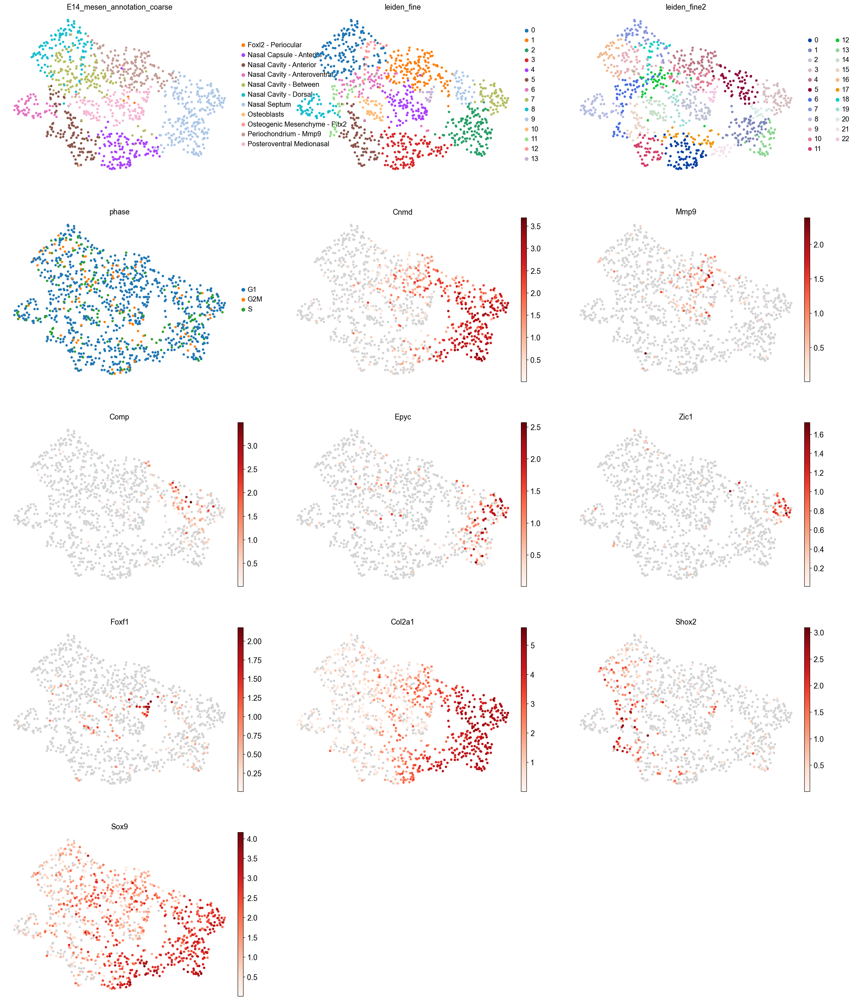

In [243]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_nasal,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','leiden_fine','leiden_fine2','phase',
           'Cnmd','Mmp9','Comp','Epyc','Zic1','Foxf1','Col2a1','Shox2','Sox9'],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 80,
    cmap = reds,
    vmin=0.01,
)


In [36]:
sc.tl.rank_genes_groups(adata_E14_nasal,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


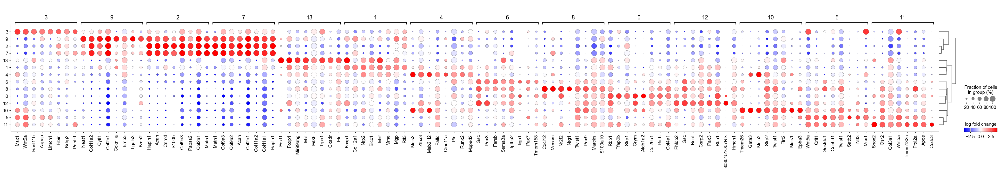

In [37]:
sc.tl.dendrogram(adata_E14_nasal, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_nasal,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

categories: 0, 1, 2, etc.
var_group_labels: 5


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


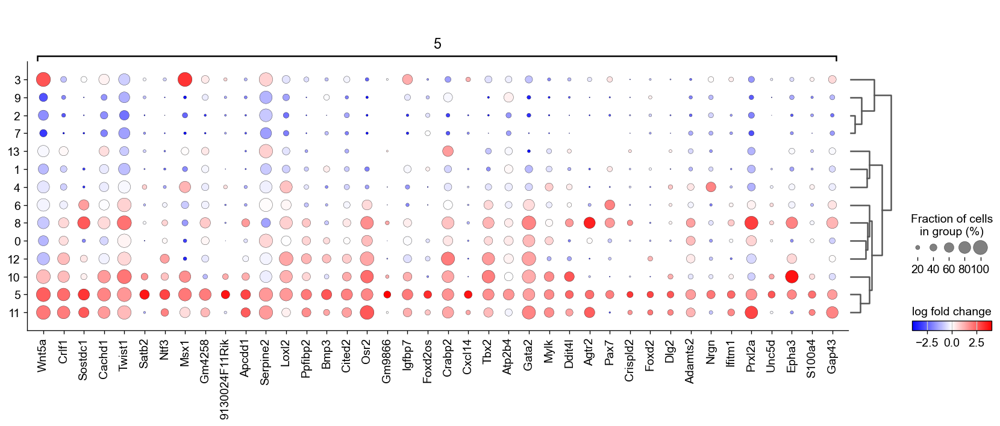

In [244]:
sc.tl.dendrogram(adata_E14_nasal, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_nasal,
                                n_genes=40,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                groups = ['5'],
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


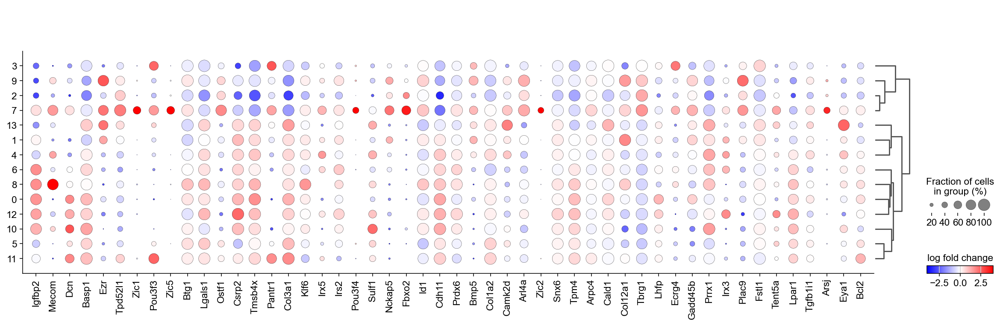

In [164]:
cluster_of_interest = '7'
reference_cluster = '2'
cat_name = 'leiden_fine'
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.tl.rank_genes_groups(adata_E14_nasal, cat_name, groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon',key_added = 'test')
number_of_genes = 50
genes = adata_E14_nasal.uns['test']['names'][cluster_of_interest][:number_of_genes].tolist()
sc.pl.rank_genes_groups_dotplot(adata_E14_nasal,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


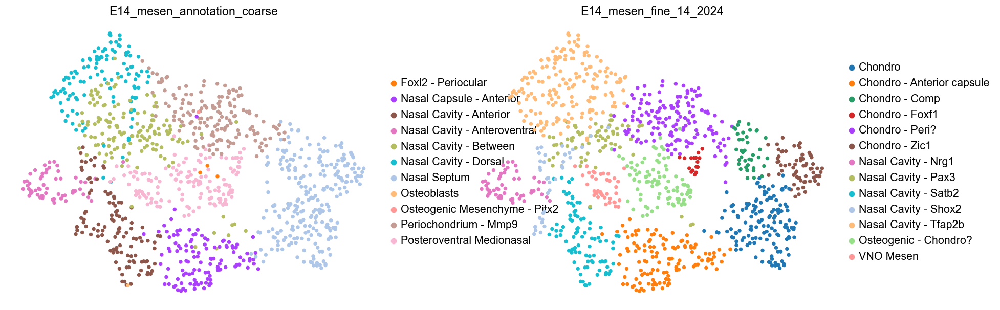

In [65]:
adata_E14_nasal.obs['E14_mesen_fine_14_2024'] = 'test'

adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Anterior capsule' #msx1, Wnt5a
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '9'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Comp' #Comp
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '7'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Zic1' #probably braincase
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro'
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '13'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Foxf1'#Foxf1, Foxp1 very strange small subset of cells
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Peri?'#Maf and Mmp9, Perichondrium? Foxp1. Lacks the foxf1, otherwise similar to 13
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Chondro?' #Gata3, need to find markers, clusters with chondro. Has runx2 and Clec11a
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Nrg1' #Nrg1, Mecom
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Tfap2b' #Tfap2b, Aldh1a2
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '12'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Tfap2b' #Tfap2b, Aldh1a2
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '10'].obs.index,'E14_mesen_fine_14_2024'] = 'VNO Mesen'#Lgr5, Gata3
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '11'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Shox2'#Shox2, Ccdc3
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Satb2'#Satb2, Wnt5a, is this ossifying? very anterior I think, see genepaint
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '6'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Pax3'#kind of similar, but 0 lacks pax3
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''
adata_E14_nasal.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''

sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_nasal,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','E14_mesen_fine_14_2024',],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 80,
    cmap = reds,
    vmin=0.01,
)


1720686700.1473923: Regressing cell cycle
1720686717.3959808: Highly Variable Genes
1720686717.494537: PCA
1720686717.5494144: Neighbors
1720686717.5963123: MDE and UMAP
1720686719.252707: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


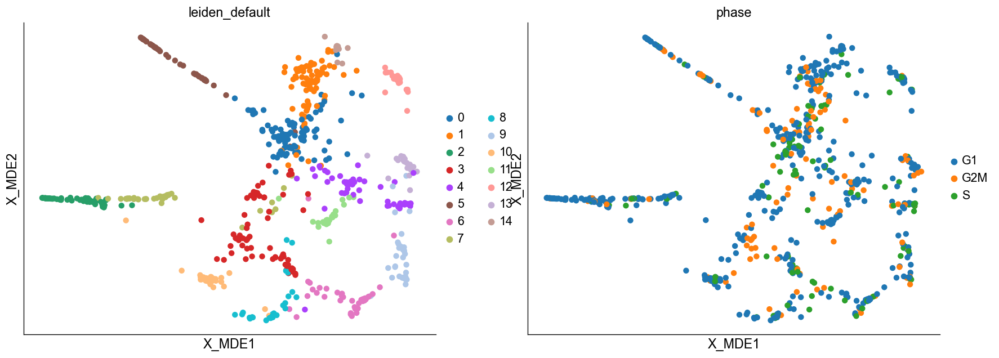

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


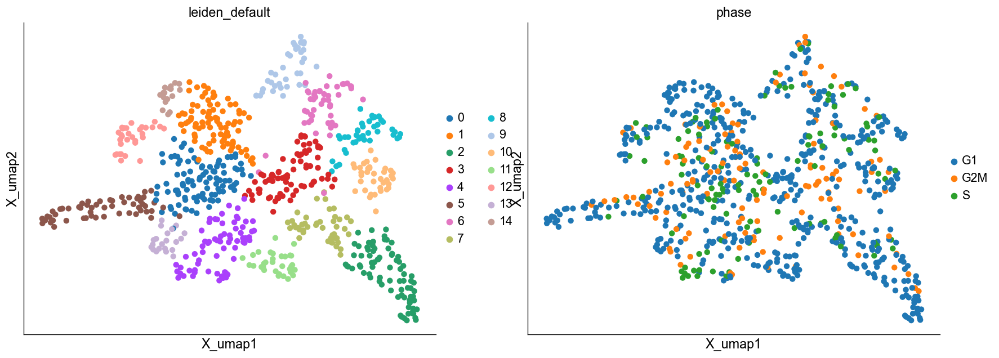

In [72]:
adata_E14_palate = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_coarse'].isin(['8','7','0','6'])].copy()
default_regress_cycle_to_mde(adata_E14_palate, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = 1,n_top_genes = 1500)
adata_E14_palate.X = adata_E14_palate.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E14_palate, target_sum=1e4)
sc.pp.log1p(adata_E14_palate)

In [195]:
sc.tl.leiden(adata_E14_palate, #name of anndata object
              resolution = .8, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E14_palate, #name of anndata object
              resolution = 1.5, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


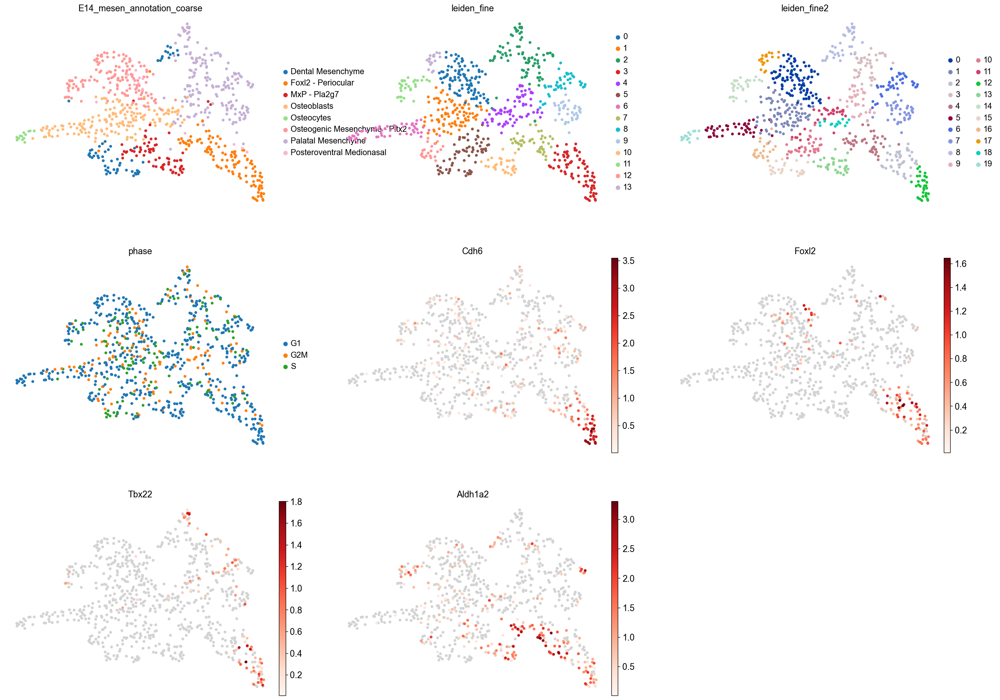

In [220]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_palate,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','leiden_fine','leiden_fine2','phase',
           'Cdh6','Foxl2','Tbx22','Aldh1a2',],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 80,
    cmap = reds,
    vmin=0.01,
)


In [197]:
sc.tl.rank_genes_groups(adata_E14_palate,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


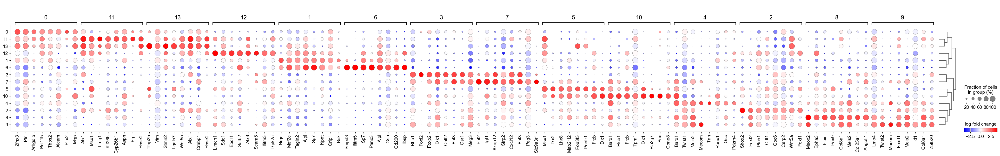

In [198]:
sc.tl.dendrogram(adata_E14_palate, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_palate,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

categories: 0, 1, 2, etc.
var_group_labels: 7


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


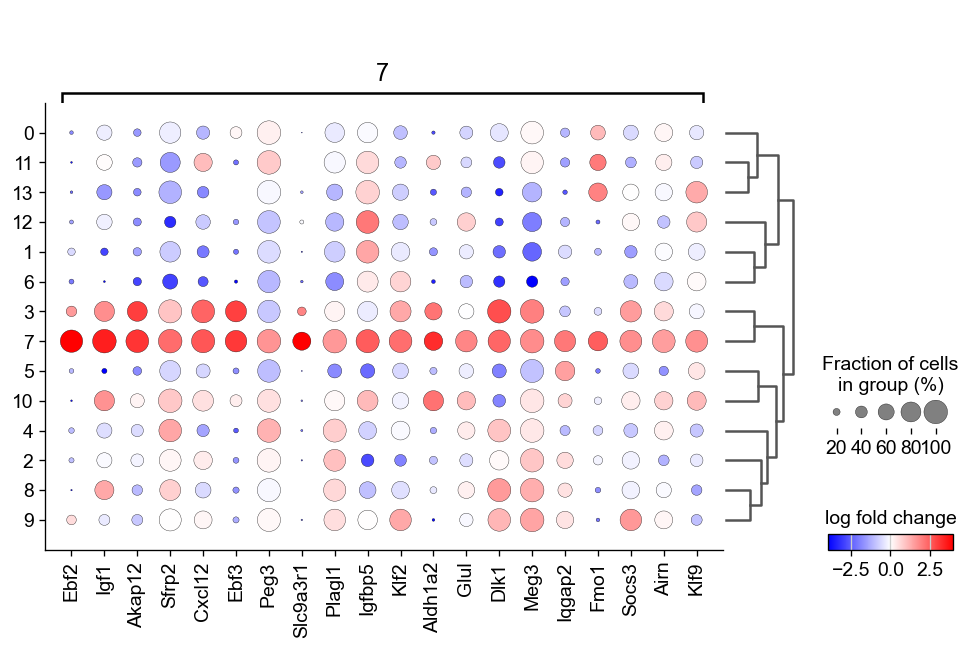

In [216]:
sc.tl.dendrogram(adata_E14_palate, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_palate,
                                n_genes=20,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                groups = ['7'],
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


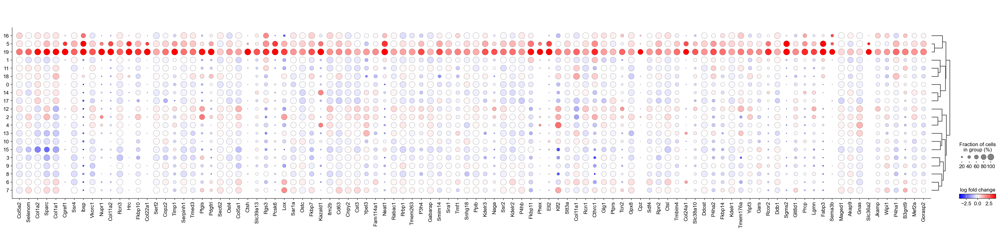

In [186]:
cluster_of_interest = '19'
reference_cluster = '5'
cat_name = 'leiden_fine'
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.tl.rank_genes_groups(adata_E14_palate, cat_name, groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon',key_added = 'test')
number_of_genes = 100
genes = adata_E14_palate.uns['test']['names'][cluster_of_interest][:number_of_genes].tolist()
sc.pl.rank_genes_groups_dotplot(adata_E14_palate,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


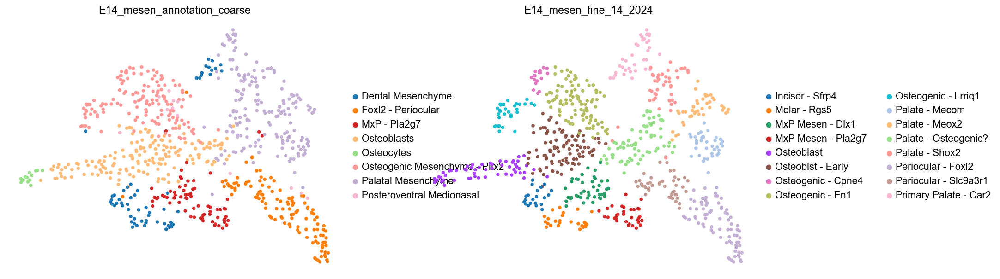

In [121]:
adata_E14_palate.obs['E14_mesen_fine_14_2024'] = 'test'

adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '6'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteoblast' #Ibsp
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '12'].obs.index,'E14_mesen_fine_14_2024'] = 'Incisor - Sfrp4' #
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteoblst - Early' #Sp7, Alpl
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '11'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Lrriq1' #Lrriq1, Erg,Slc35f2,Runx2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '13'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Cpne4' #Cpne4, Tfap2b, Runx2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - En1' #En1, Pitx2, little higher but not massive. Runx2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Periocular - Foxl2' #Foxl2, Cdh6, Slc26a7, Foxp2, Rspo2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '7'].obs.index,'E14_mesen_fine_14_2024'] = 'Periocular - Slc9a3r1' #Seems to be anterior of the eye
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'MxP Mesen - Dlx1' #Dlx1, Dlx2, No Pla2g7
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '10'].obs.index,'E14_mesen_fine_14_2024'] = 'MxP Mesen - Pla2g7' #Pla2g7, Scx, Dlx1/2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Osteogenic?' #Mecom, Tnn, Runx2, Barx1
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Shox2' #Shox2 Asb4
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Meox2' #Meox2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '9'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Mecom' #Mecom, Meox2
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = '' #


adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine2'] == '15'].obs.index,'E14_mesen_fine_14_2024'] = 'Molar - Rgs5' #Rgs5, Tfap2b
adata_E14_palate.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine2'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Primary Palate - Car2'#car2, Foxd1

sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_palate,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','E14_mesen_fine_14_2024'],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 80,
    cmap = reds,
    vmin=0.01,
)



1720689276.392829: Regressing cell cycle
1720689290.0575132: Highly Variable Genes
1720689290.1097205: PCA
1720689290.1428914: Neighbors
1720689290.1512554: MDE and UMAP
1720689291.490564: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


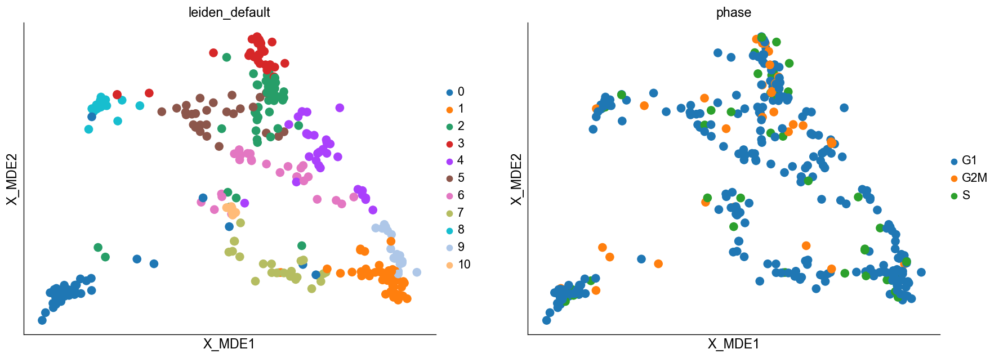

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


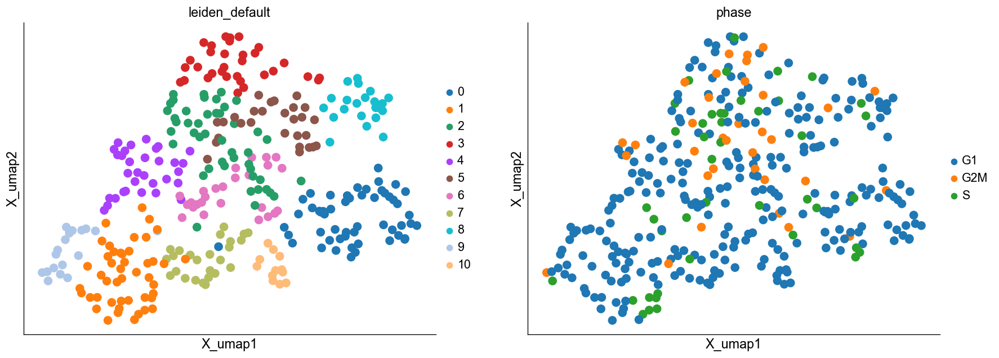

In [123]:
adata_E14_dermal = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_coarse'].isin(['1'])].copy()
default_regress_cycle_to_mde(adata_E14_dermal, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = 1,n_top_genes = 1500)
adata_E14_dermal.X = adata_E14_dermal.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E14_dermal, target_sum=1e4)
sc.pp.log1p(adata_E14_dermal)

In [283]:
sc.tl.leiden(adata_E14_dermal, #name of anndata object
              resolution = .5, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E14_dermal, #name of anndata object
              resolution = 1, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


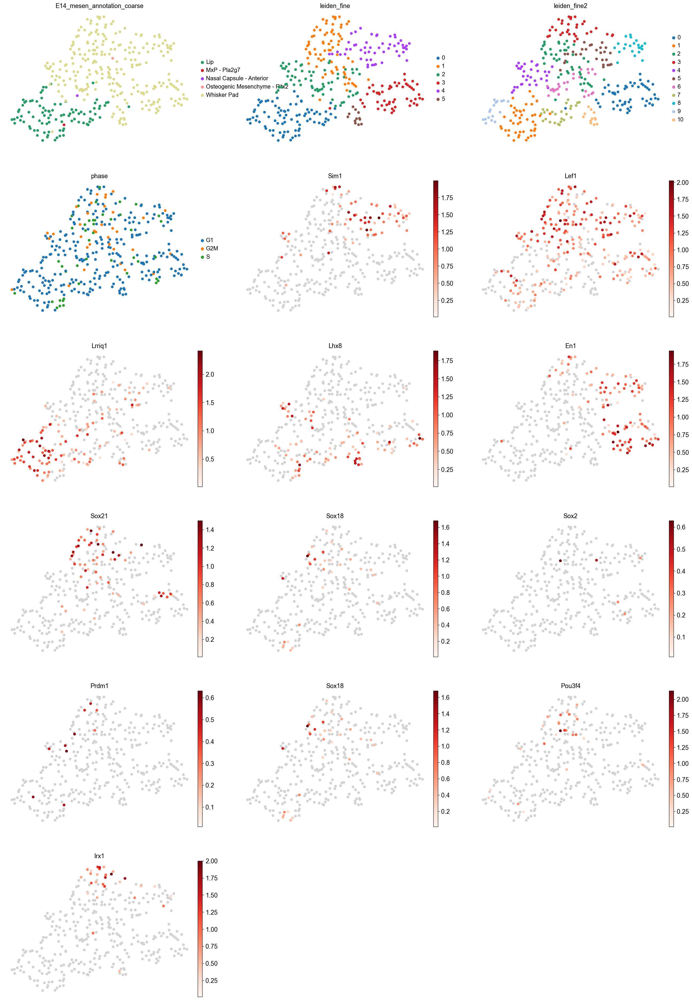

In [285]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_dermal,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','leiden_fine','leiden_fine2','phase',
           'Sim1','Lef1','Lrriq1','Lhx8','En1','Sox21','Sox18','Sox2','Prdm1','Sox18','Pou3f4','Irx1',],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 150,
    cmap = reds,
    vmin=0.01,
)


In [277]:
sc.tl.rank_genes_groups(adata_E14_dermal,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


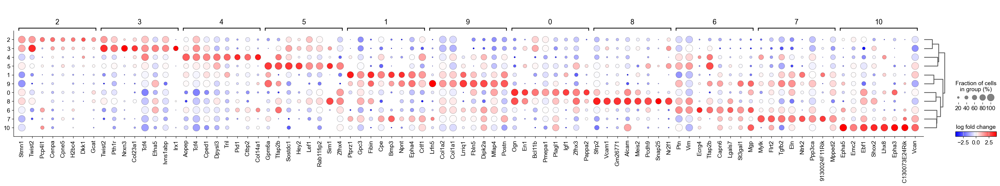

In [278]:
sc.tl.dendrogram(adata_E14_dermal, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_dermal,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

categories: 0, 1, 2, etc.
var_group_labels: 3


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


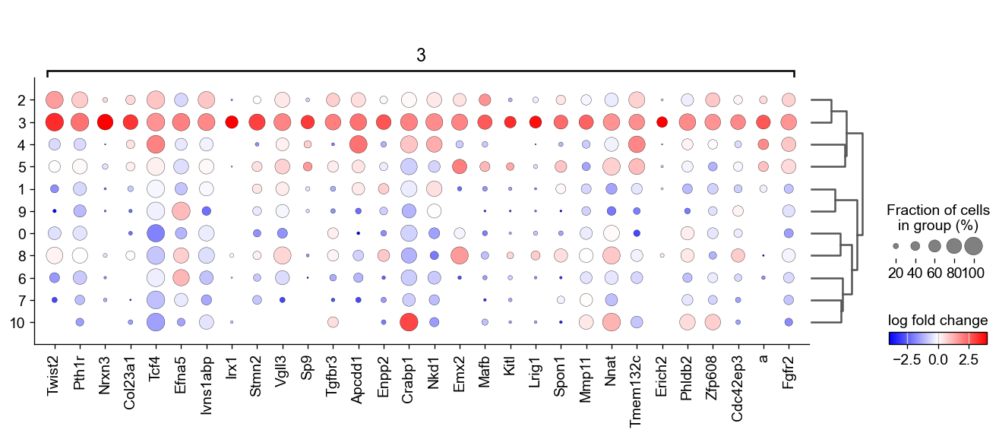

In [281]:
sc.tl.dendrogram(adata_E14_dermal, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E14_dermal,
                                n_genes=30,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                groups = ['3'],
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

In [ ]:
cluster_of_interest = '6'
reference_cluster = '0'
cat_name = 'leiden_fine'
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.tl.rank_genes_groups(adata_E14_dermal, cat_name, groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon',key_added = 'test')
number_of_genes = 50
genes = adata_E14_dermal.uns['test']['names'][cluster_of_interest][:number_of_genes].tolist()
sc.pl.rank_genes_groups_dotplot(adata_E14_dermal,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


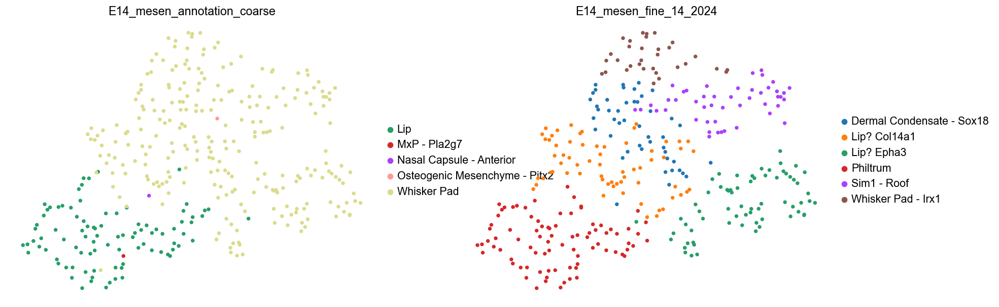

In [286]:
adata_E14_dermal.obs['E14_mesen_fine_14_2024'] = 'test'

adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Philtrum' #Lrriq1, Bmp3, Pappa
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Sim1 - Roof' #Sim1
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Dermal Condensate - Sox18' #Sox21, Lef1
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Col14a1' #Col14a1, Msx2, Tfap2b
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Epha3' #Epha3
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Epha3' #Epha3

adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine2'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Dermal Condensate - Sox18' #Sox18
adata_E14_dermal.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine2'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Whisker Pad - Irx1' #Irx1



sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E14_dermal,
    basis='X_umap',
    color=['E14_mesen_annotation_coarse','E14_mesen_fine_14_2024'],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 80,
    cmap = reds,
    vmin=0.01,
)



/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


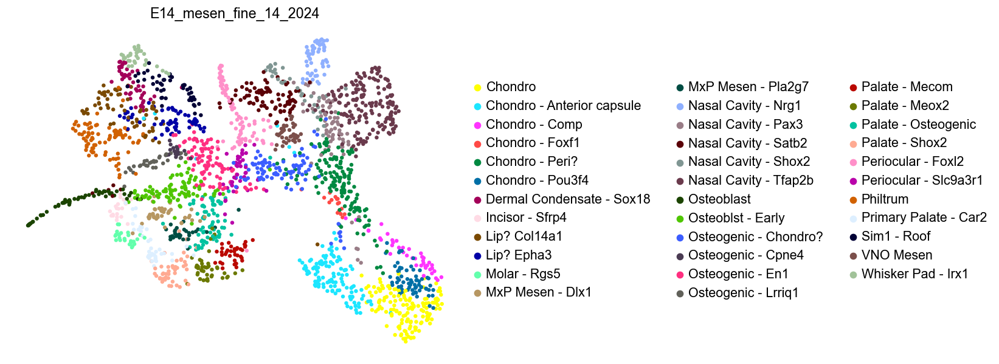

In [287]:
adata_E14_mesen_filt.obs['E14_mesen_fine_14_2024'] = 'test'

#nasal
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Anterior capsule' #msx1, Wnt5a
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '9'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Comp' #Comp
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '7'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Pou3f4' #probably otic capsule, Zic1/2/5
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro'
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '13'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Foxf1'#Foxf1, Foxp1 very strange small subset of cells
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Chondro - Peri?'#Maf and Mmp9, Perichondrium? Foxp1. Lacks the foxf1, otherwise similar to 13
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Chondro?' #Gata3, need to find markers, clusters with chondro. Has runx2 and Clec11a
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Nrg1' #Nrg1, Mecom
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Tfap2b' #Tfap2b, Aldh1a2
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '12'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Tfap2b' #Tfap2b, Aldh1a2
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '10'].obs.index,'E14_mesen_fine_14_2024'] = 'VNO Mesen'#Lgr5, Gata3
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '11'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Shox2'#Shox2, Ccdc3
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Satb2'#Satb2, Wnt5a, is this ossifying? very anterior I think, see genepaint
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == '6'].obs.index,'E14_mesen_fine_14_2024'] = 'Nasal Cavity - Pax3'#kind of similar, but 0 lacks pax3
adata_E14_mesen_filt.obs.loc[adata_E14_nasal[adata_E14_nasal.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = ''

#palate/bone
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '6'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteoblast' #Ibsp
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '12'].obs.index,'E14_mesen_fine_14_2024'] = 'Incisor - Sfrp4' #
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteoblst - Early' #Sp7, Alpl
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '11'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Lrriq1' #Lrriq1, Erg,Slc35f2,Runx2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '13'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - Cpne4' #Cpne4, Tfap2b, Runx2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Osteogenic - En1' #En1, Pitx2, little higher but not massive. Runx2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Periocular - Foxl2' #Foxl2, Cdh6, Slc26a7, Foxp2, Rspo2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '7'].obs.index,'E14_mesen_fine_14_2024'] = 'Periocular - Slc9a3r1' #
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'MxP Mesen - Dlx1' #Dlx1, Dlx2, No Pla2g7
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '10'].obs.index,'E14_mesen_fine_14_2024'] = 'MxP Mesen - Pla2g7' #Pla2g7, Scx, Dlx1/2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Osteogenic' #Mecom, Tnn, Runx2, Barx1
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Shox2' #Shox2 Asb4
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Meox2' #Meox2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == '9'].obs.index,'E14_mesen_fine_14_2024'] = 'Palate - Mecom' #Mecom, Meox2
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine'] == ''].obs.index,'E14_mesen_fine_14_2024'] = '' #


adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine2'] == '15'].obs.index,'E14_mesen_fine_14_2024'] = 'Molar - Rgs5' #Rgs5, Tfap2b
adata_E14_mesen_filt.obs.loc[adata_E14_palate[adata_E14_palate.obs['leiden_fine2'] == '8'].obs.index,'E14_mesen_fine_14_2024'] = 'Primary Palate - Car2'#car2, Foxd1


#dermal
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '0'].obs.index,'E14_mesen_fine_14_2024'] = 'Philtrum' #Lrriq1, Bmp3, Pappa
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '4'].obs.index,'E14_mesen_fine_14_2024'] = 'Sim1 - Roof' #Sim1
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '1'].obs.index,'E14_mesen_fine_14_2024'] = 'Dermal Condensate - Sox18' #Sox21, Lef1, Pou3f4
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Col14a1' #Col14a1, Msx2, Tfap2b
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Epha3' #Epha3
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine'] == '5'].obs.index,'E14_mesen_fine_14_2024'] = 'Lip? Epha3' #Epha3

adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine2'] == '2'].obs.index,'E14_mesen_fine_14_2024'] = 'Dermal Condensate - Sox18' #Sox18
adata_E14_mesen_filt.obs.loc[adata_E14_dermal[adata_E14_dermal.obs['leiden_fine2'] == '3'].obs.index,'E14_mesen_fine_14_2024'] = 'Whisker Pad - Irx1' #Irx1

###chondro
#'Chondro - Pou3f4', Remove, otic capsule
#'Chondro - Anterior capsule' #msx1, Wnt5a
#Main chondro = 'Chondro - Comp' #Comp and 'Chondro'
#perichondrium cluster in quoatation

#osteo related
#Osteoblast Late, Mid, Early 
    #sost
    #Col22a1, Ibsp
    #Sp7, Alpl,

#Osteomesenchyme
    #merge all osteomesenchyme
    
#palate and teeth
    #primary palate - Car2, Foxd1
    #Palate anterior - Shox2 Asb4
    #palate posterior - Meox2, Sim2,Mecom
    #incisor - Sfrp4
    #Molar - Rgs5, Tfap2b

#MxP
    #merge two mxp around nerve

#Periocular
    #Merge the two, Foxl2, Cdh6, Aldh1a2

#Dermal
    #Whisker pad - Sox21
    #demral condensate - Sox18, Pou3f4
    #Nostril - Lhx8, Gata2
    #Lip - Dlk1, Fibro
    #Philtrum - Lrriq1, Pappa
    #Sim1 Roof

#Nasal Cavity/VNO
    #VNO Mesen - Lgr5, Dkk1, Gata3
    
    #Merge nasal cavity



sc.pl.embedding(
    adata_E14_mesen_filt,
    size=60,
    basis='X_umap',
    color=['E14_mesen_fine_14_2024',
          ],
    #groups=['23','20'],
    #groups=['8','7','0','6'],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


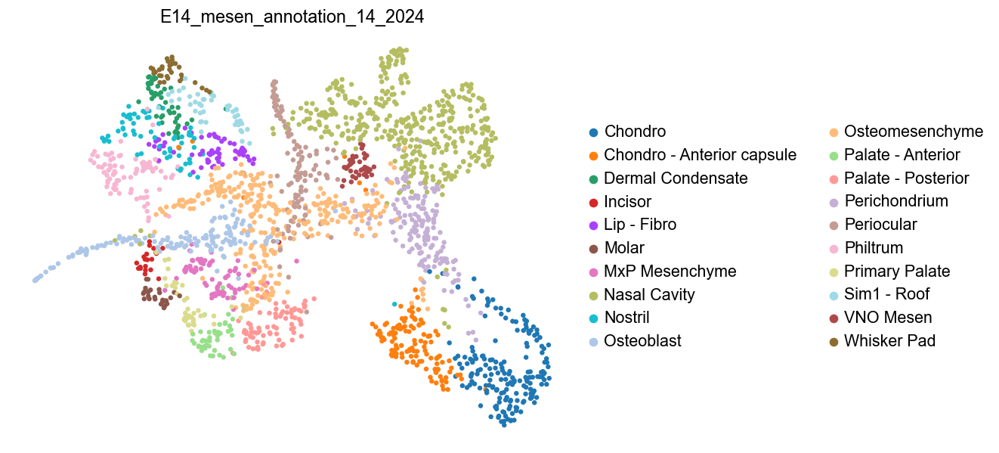

In [290]:
#first we remove the otic capsule chondro, Zic1/2/5 and Pou3f4 positive
adata_E14_mesen_filtered = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['E14_mesen_fine_14_2024']!='Chondro - Pou3f4'].copy()

adata_E14_mesen_filt.obs['E14_mesen_annotation_14_2024'] = 'test'

#Chondro
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Comp'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Anterior capsule'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro - Anterior capsule'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Peri?'].obs.index,'E14_mesen_annotation_14_2024'] = 'Perichondrium'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Foxf1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Perichondrium'

#osteo
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteoblast'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteoblast'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteoblst - Early'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteoblast'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Chondro?'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Lrriq1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Cpne4'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - En1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Osteogenic'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'


#palate and teeth
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Incisor - Sfrp4'].obs.index,'E14_mesen_annotation_14_2024'] = 'Incisor'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Molar - Rgs5'].obs.index,'E14_mesen_annotation_14_2024'] = 'Molar'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Primary Palate - Car2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Primary Palate'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Osteogenic'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Shox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Anterior'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Meox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Posterior'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Mecom'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Posterior'

#MxP mesen
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'MxP Mesen - Dlx1'].obs.index,'E14_mesen_annotation_14_2024'] = 'MxP Mesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'MxP Mesen - Pla2g7'].obs.index,'E14_mesen_annotation_14_2024'] = 'MxP Mesenchyme'

#Periocular
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Periocular - Foxl2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Periocular'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Periocular - Slc9a3r1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Periocular'

#dermal
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Philtrum'].obs.index,'E14_mesen_annotation_14_2024'] = 'Philtrum'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Sim1 - Roof'].obs.index,'E14_mesen_annotation_14_2024'] = 'Sim1 - Roof'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Whisker Pad - Irx1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Whisker Pad'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Dermal Condensate - Sox18'].obs.index,'E14_mesen_annotation_14_2024'] = 'Dermal Condensate'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Lip? Col14a1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nostril'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Lip? Epha3'].obs.index,'E14_mesen_annotation_14_2024'] = 'Lip - Fibro'

#nasal cavity/vno
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'VNO Mesen'].obs.index,'E14_mesen_annotation_14_2024'] = 'VNO Mesen'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Nrg1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Tfap2b'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Shox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Satb2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Pax3'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'


sc.pl.embedding(
    adata_E14_mesen_filtered,
    size=60,
    basis='X_umap',
    color=['E14_mesen_annotation_14_2024',
          ],
    #groups=['23','20'],
    #groups=['8','7','0','6'],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

In [291]:
adata_E14_mesen_filtered.write('anndata_objects/adata_E14_mesen_annotation.h5ad')

1709913420.3284612: Highly Variable Genes
1709913420.633917: PCA
1709913420.6730883: Neighbors
1709913425.5221786: MDE and UMAP
1709913427.2343247: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


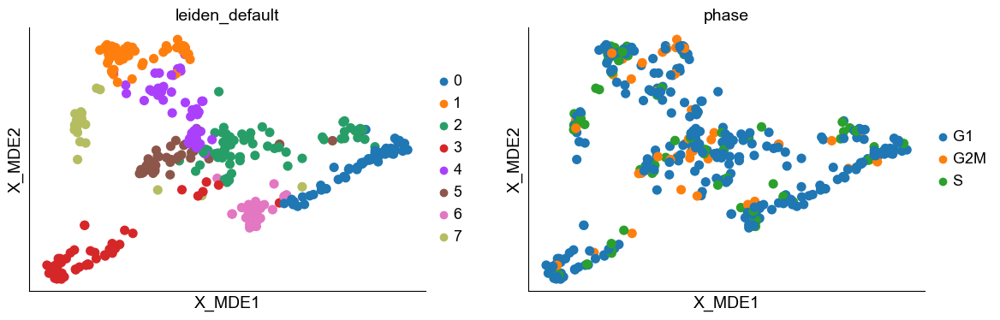

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


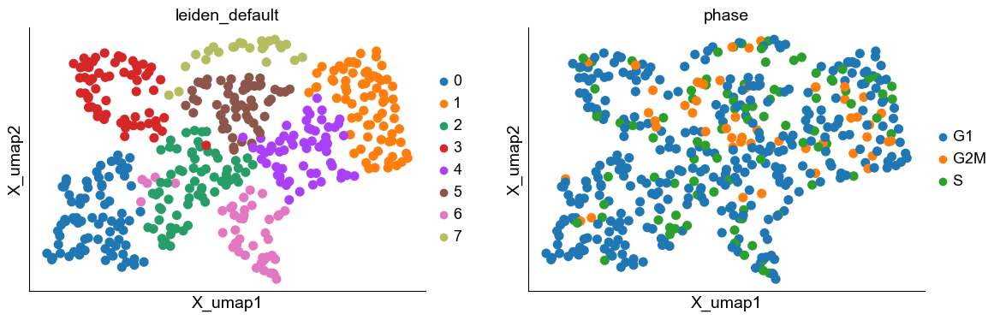

In [55]:
adata_mesen_cavity = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['leiden_mesen'].isin(['4','7','10','16',])].copy()
default_regress_cycle_to_mde(adata_mesen_cavity, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = .5,n_top_genes = 2000)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


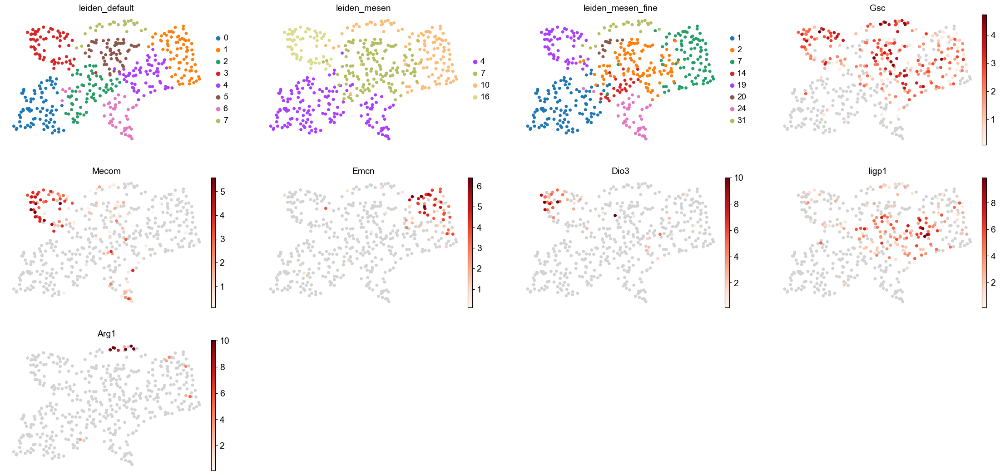

In [92]:
sc.pl.embedding(
    adata_mesen_cavity,
    size=100,
    basis='X_umap',
    color=['leiden_default','leiden_mesen','leiden_mesen_fine',
           'Gsc','Mecom','Emcn','Dio3','Iigp1','Arg1',
          ],
    #groups=['23','20'],
    #groups=['0','1','3','4','5','6','7','8','10','12','13'],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


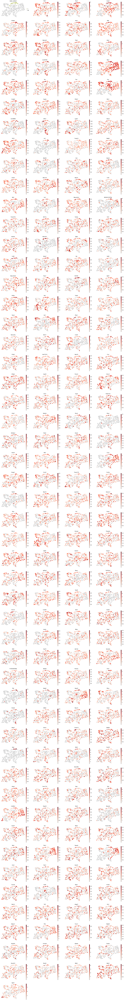

In [93]:
plot_deg_embedding(
    #adata = adata_E12_mesen_no_filt[adata_E12_mesen_no_filt.obs['leiden']!='19'], 
    adata = adata_mesen_cavity,
                   groupby = 'leiden_default', 
                   cluster_name = '7', 
                   n_genes = 200, 
                   method = 't-test',
                   basis = 'X_umap')

In [20]:
#default_regress_cycle_to_mde(adata_E14_mesen_filt, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = .5,n_top_genes = 2000)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


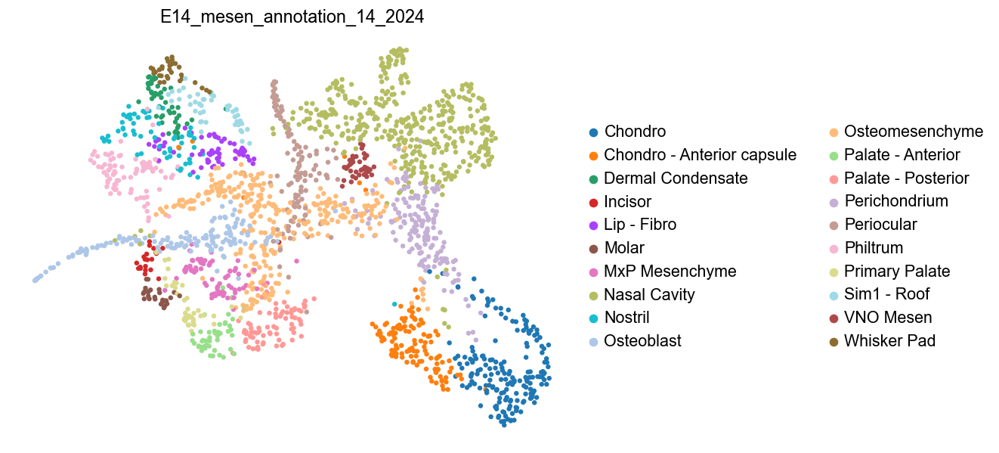

In [290]:
#first we remove the otic capsule chondro, Zic1/2/5 and Pou3f4 positive
adata_E14_mesen_filtered = adata_E14_mesen_filt[adata_E14_mesen_filt.obs['E14_mesen_fine_14_2024']!='Chondro - Pou3f4'].copy()

adata_E14_mesen_filt.obs['E14_mesen_annotation_14_2024'] = 'test'

#Chondro
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Comp'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Anterior capsule'].obs.index,'E14_mesen_annotation_14_2024'] = 'Chondro - Anterior capsule'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Peri?'].obs.index,'E14_mesen_annotation_14_2024'] = 'Perichondrium'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Chondro - Foxf1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Perichondrium'

#osteo
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteoblast'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteoblast'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteoblst - Early'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteoblast'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Chondro?'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Lrriq1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - Cpne4'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Osteogenic - En1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Osteogenic'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'


#palate and teeth
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Incisor - Sfrp4'].obs.index,'E14_mesen_annotation_14_2024'] = 'Incisor'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Molar - Rgs5'].obs.index,'E14_mesen_annotation_14_2024'] = 'Molar'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Primary Palate - Car2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Primary Palate'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Osteogenic'].obs.index,'E14_mesen_annotation_14_2024'] = 'Osteomesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Shox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Anterior'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Meox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Posterior'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Palate - Mecom'].obs.index,'E14_mesen_annotation_14_2024'] = 'Palate - Posterior'

#MxP mesen
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'MxP Mesen - Dlx1'].obs.index,'E14_mesen_annotation_14_2024'] = 'MxP Mesenchyme'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'MxP Mesen - Pla2g7'].obs.index,'E14_mesen_annotation_14_2024'] = 'MxP Mesenchyme'

#Periocular
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Periocular - Foxl2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Periocular'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Periocular - Slc9a3r1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Periocular'

#dermal
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Philtrum'].obs.index,'E14_mesen_annotation_14_2024'] = 'Philtrum'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Sim1 - Roof'].obs.index,'E14_mesen_annotation_14_2024'] = 'Sim1 - Roof'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Whisker Pad - Irx1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Whisker Pad'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Dermal Condensate - Sox18'].obs.index,'E14_mesen_annotation_14_2024'] = 'Dermal Condensate'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Lip? Col14a1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nostril'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Lip? Epha3'].obs.index,'E14_mesen_annotation_14_2024'] = 'Lip - Fibro'

#nasal cavity/vno
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'VNO Mesen'].obs.index,'E14_mesen_annotation_14_2024'] = 'VNO Mesen'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Nrg1'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Tfap2b'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Shox2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Satb2'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'
adata_E14_mesen_filtered.obs.loc[adata_E14_mesen_filtered[adata_E14_mesen_filtered.obs['E14_mesen_fine_14_2024'] == 'Nasal Cavity - Pax3'].obs.index,'E14_mesen_annotation_14_2024'] = 'Nasal Cavity'


sc.pl.embedding(
    adata_E14_mesen_filtered,
    size=60,
    basis='X_umap',
    color=['E14_mesen_annotation_14_2024',
          ],
    #groups=['23','20'],
    #groups=['8','7','0','6'],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

1709824486.5650296: Regressing cell cycle
1709824501.8506427: Highly Variable Genes
1709824501.9148254: PCA
1709824501.9625907: Neighbors
1709824501.9890788: MDE and UMAP
1709824504.4761457: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


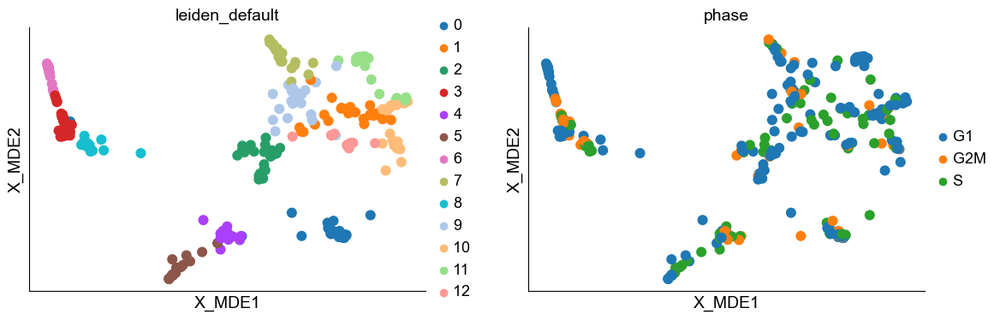

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


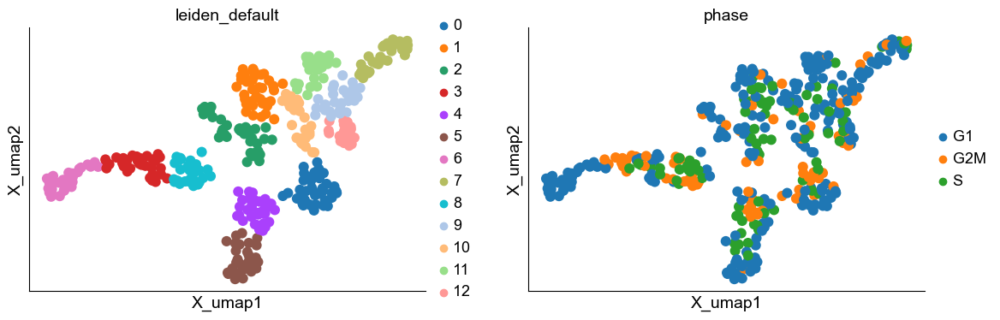

In [34]:
adata_E14_ecto = adata_E14[adata_E14.obs['leiden'].isin(['9','11','13'])].copy()
default_regress_cycle_to_mde(adata_E14_ecto, n_neighbors = 15,n_comps=30, skip_preprocess = False, resolution = 1.1,n_top_genes = 3000)



In [48]:
adata_E14_ecto = sc.read('anndata_objects/adata_E14_ecto_annotated.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


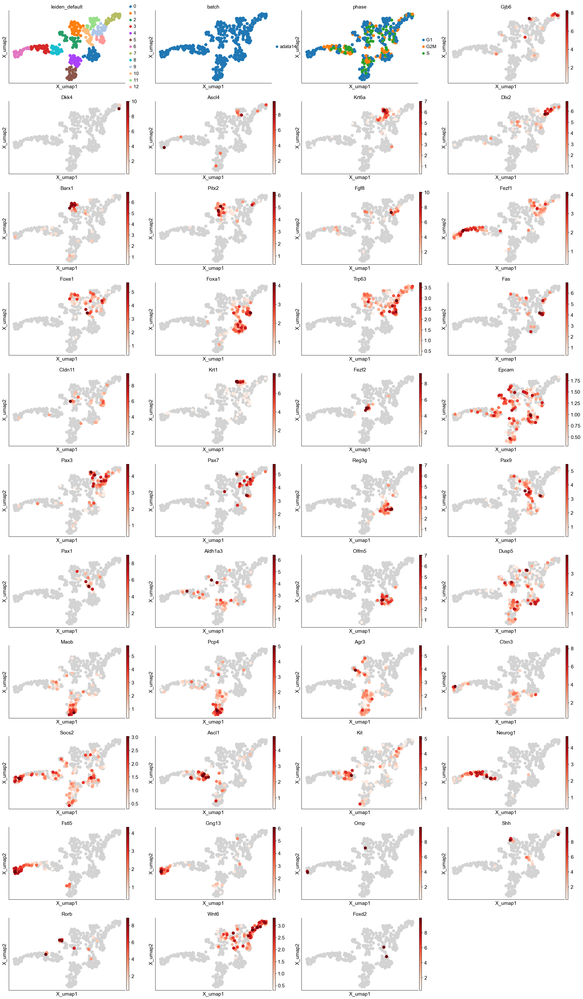

In [49]:
sc.pl.embedding(adata_E14_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['leiden_default','batch','phase',
                         'Gjb6','Dkk4','Ascl4','Krt6a','Dlx2','Barx1','Pitx2','Fgf8','Fezf1','Foxe1','Foxa1','Trp63','Fas','Cldn11','Krt1',
                         'Fezf2','Epcam','Pax3','Pax7','Reg3g','Pax9','Pax1','Aldh1a3','Olfm5','Dusp5','Maob','Pcp4','Agr3','Ctxn3','Socs2',
                         'Ascl1','Kit','Neurog1','Fstl5','Gng13','Omp','Shh','Rorb','Wnt6','Foxd2',],
           ncols=4, cmap=reds, vmin=0.3)


#Gjb6 tip
#dlx2 middle

#Fas Trp63 Foxa1 Cldn11 Cluster
#Krt6a Krt1 periderm
#Fgf8 cluster

#split up Barx1 and Pitx2 for palate and oral

#foxa1 reg3g respiratory epithelium, now expresses olfm5, olfm5 cells lost aldh1a3
#aldh1a3 cluster Ventral stuff


#remove otic cluster Oc90+ Ush1c(side otic cluster expresses cartilage markers), Leave fezf2+ Car2+ cells from vomer

#remove Pax1+ Pax9+ cluster, this is likely endoderm from the back of the mouth/throat behind tongue

###############
###############

#Fezf2 Vomer
#Ascl4+ whisker, make sure to subcluster from Gjb6+
#Gjb6+ Pou3f1+ doesn't overlap with whisker, subcluster this from Gjb6+
#Dlx2+ cluster 
#Fgf8+ Dlx2+ Wnt5a  olfactory pit rim 
#Barx1 + Shh = Palate; also add foxe1+ barx1- Wnt6+ to palate (Foxe1 Foxa1 meeting point?)
#Dlx2 + Pitx2 = Oral 

#Reg3g + Foxa1 together is respiratory epithelium (
#Olfm5+ Aldh1a3+
#other big Aldh1a3+ Ventral Olf?


#2 Krt6a clusters are Periderm
#Maob Pcp4 Cyp2g1 Non neuronal precursor
#Aldh1a3 Maob Ctxn3 Agr3 transition between pcp4 and respiratory?

#'Ascl1','Kit','Insm1' Neuronal progenitors

#Neurog1 Committed neuronal progenitors
#'Fstl5'+,'Gfy'+, 'Gng13- Immature neurons
#'Gng13','Prph','Omp' More mature Neurons

# 'Krt5','Krt14','Krt15','Krt17','Krt19','Krt6a','Krt7','Irx2',
#                          'Dlx1','Dlx2','Rorb','Gjb6','Irx4','Barx1','Pitx2','Fgf8',
#                          'Wnt3','Wnt5a','Wnt7b','Wnt9a','Wnt10a','Wnt10b',
#                          'Pax7','Fgf8','Foxa1','Aldh1a3','Reg3g','Olfm5','Sult1e1','Maob','Pcp4','Krt23',
#                          'Ascl1','Kit','Neurog1','Fstl5','Gfy','Omp','Prph','Gng8','Gng13','Rgs5',
#                          'Agr3','Otx2','Ermn','Pax6','Pou3f1','Gata3','Msx2',


In [ ]:
#Gjb6 tip
#dlx2 middle

#Fas Trp63 Foxa1 Cldn11 Cluster
#Krt6a Krt1 periderm
#Fgf8 cluster

#split up Barx1 and Pitx2 for palate and oral

#foxa1 reg3g respiratory epithelium, now expresses olfm5, olfm5 cells lost aldh1a3
#aldh1a3 cluster Ventral stuff


#remove otic cluster Oc90+ Ush1c(side otic cluster expresses cartilage markers), Leave fezf2+ Car2+ cells from vomer

#remove Pax1+ Pax9+ cluster, this is likely endoderm from the back of the mouth/throat behind tongue

###############
###############

#Fezf2 Vomer
#Ascl4+ whisker, make sure to subcluster from Gjb6+
#Gjb6+ Pou3f1+ doesn't overlap with whisker, subcluster this from Gjb6+
#Dlx2+ cluster 
#Fgf8+ Dlx2+ Wnt5a  olfactory pit rim 
#Barx1 + Shh = Palate; also add foxe1+ barx1- Wnt6+ to palate (Foxe1 Foxa1 meeting point?)
#Dlx2 + Pitx2 = Oral 

#Reg3g + Foxa1 together is respiratory epithelium (
#Olfm5+ Aldh1a3+
#other big Aldh1a3+ Ventral Olf?


#2 Krt6a clusters are Periderm
#Maob Pcp4 Cyp2g1 Non neuronal precursor
#Aldh1a3 Maob Ctxn3 Agr3 transition between pcp4 and respiratory?

#'Ascl1','Kit','Insm1' Neuronal progenitors

#Neurog1 Committed neuronal progenitors
#'Fstl5'+,'Gfy'+, 'Gng13- Immature neurons
#'Gng13','Prph','Omp' More mature Neurons


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


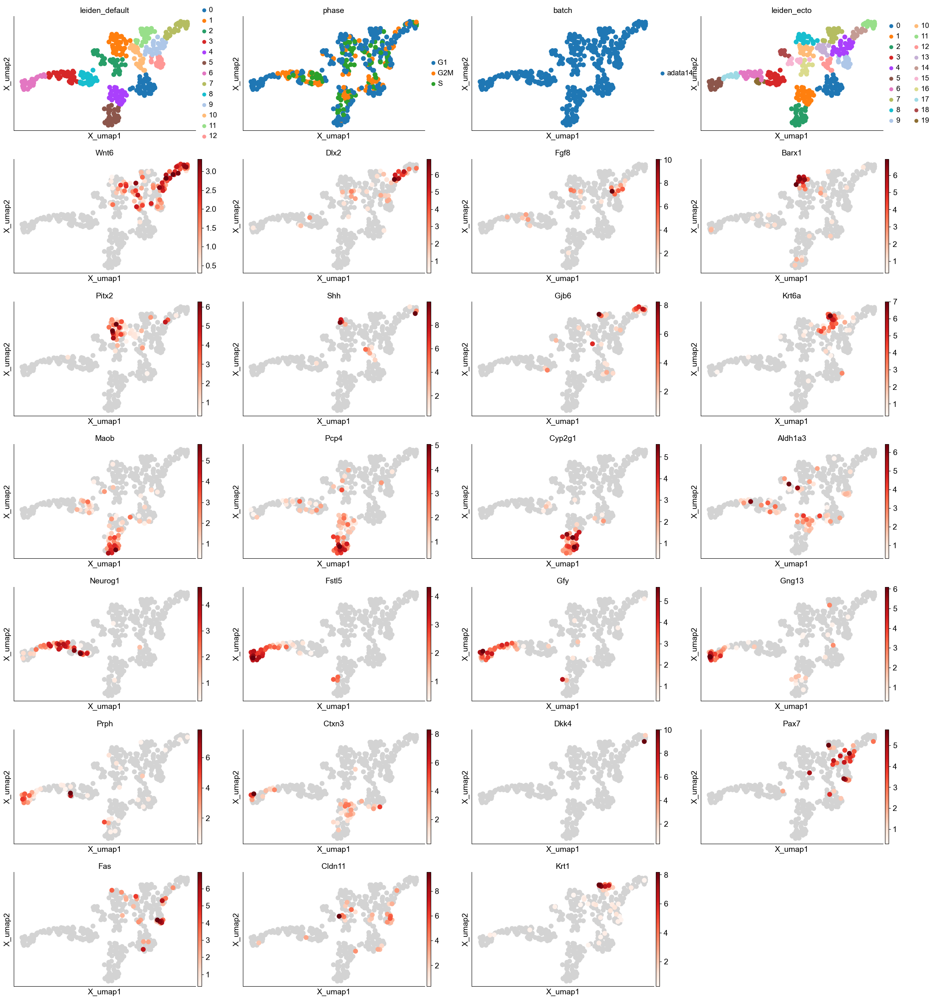

In [65]:
sc.tl.leiden(adata_E14_ecto, resolution = 3, key_added = 'leiden_ecto')
sc.pl.embedding(adata_E14_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['leiden_default','phase','batch','leiden_ecto','Wnt6','Dlx2','Fgf8','Barx1','Pitx2','Shh','Gjb6','Krt6a','Maob','Pcp4','Cyp2g1','Aldh1a3','Neurog1','Fstl5','Gfy',
                         'Gng13','Prph','Ctxn3','Dkk4','Pax7','Fas','Cldn11','Krt1'],
           ncols=4, cmap=reds, vmin=0.3)

In [67]:
adata_E14_ecto.obs['E14_ecto_annotation_coarse'] = 'tmp' #create new column

adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '0'].obs.index,'E14_ecto_annotation_coarse'] = 'Respiratory Epithelium' #Reg3g Olfm5 Serpinb11
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '1'].obs.index,'E14_ecto_annotation_coarse'] = 'Palate Epithelium' #Barx1 Shh
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '2'].obs.index,'E14_ecto_annotation_coarse'] = 'Vomeronasal Organ' #Fezf2 Car2
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '3'].obs.index,'E14_ecto_annotation_coarse'] = 'Committed Neuronal Progenitors' #Neurog1 Neurod1 Fstl5/Gfy-
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '4'].obs.index,'E14_ecto_annotation_coarse'] = 'Non-neuronal Progenitors' #Pcp4low Ctxn3 Cpm
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '5'].obs.index,'E14_ecto_annotation_coarse'] = 'Non-neuronal Progenitors' #Pcp4 Maob
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '6'].obs.index,'E14_ecto_annotation_coarse'] = 'Mature Neurons' #Prph Gng13
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '7'].obs.index,'E14_ecto_annotation_coarse'] = 'Surface Ectoderm - Dlx2' #Dlx2
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '8'].obs.index,'E14_ecto_annotation_coarse'] = 'Neuronal Progenitors' #Ascl1 Kit
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '9'].obs.index,'E14_ecto_annotation_coarse'] = 'Olfactory Pit Rim' #Fgf8 Pax7
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '10'].obs.index,'E14_ecto_annotation_coarse'] = 'Pharyngeal Epithelium - Remove' #Upk1b Pax1 Adamts16
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '11'].obs.index,'E14_ecto_annotation_coarse'] = 'Periderm' #Krt6a Krt1 periderm
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '12'].obs.index,'E14_ecto_annotation_coarse'] = 'Fas+ Epithelium' #Fas Cldn11

adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '10'].obs.index,'E14_ecto_annotation_coarse'] = 'Oral Epithelium' #Pitx2 Barx1-
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '11'].obs.index,'E14_ecto_annotation_coarse'] = 'Surface Ectoderm - Gjb6' #Gjb6
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '15'].obs.index,'E14_ecto_annotation_coarse'] = 'Otic - Remove' #Ush1c
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '17'].obs.index,'E14_ecto_annotation_coarse'] = 'Immature Neurons' #Fstl5/Gfy
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '18'].obs.index,'E14_ecto_annotation_coarse'] = 'Otic - Remove' #Oc90



adata_E14_ecto.obs['E14_ecto_annotation_coarse'] = adata_E14_ecto.obs['E14_ecto_annotation_coarse'].astype('category')

adata_E14_ecto.obs['E14_ecto_annotation_coarse'] = adata_E14_ecto.obs['E14_ecto_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

In [69]:
adata_E14_ecto.obs['E14_ecto_annotation_fine'] = 'tmp' #create new column

adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '0'].obs.index,'E14_ecto_annotation_fine'] = 'Respiratory Epithelium' #Reg3g Olfm5 Serpinb11
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '1'].obs.index,'E14_ecto_annotation_fine'] = 'Palate Epithelium' #Barx1 Shh
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '2'].obs.index,'E14_ecto_annotation_fine'] = 'Vomeronasal Organ' #Fezf2 Car2
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '3'].obs.index,'E14_ecto_annotation_fine'] = 'Committed Neuronal Progenitors' #Neurog1 Neurod1 Fstl5/Gfy-
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '4'].obs.index,'E14_ecto_annotation_fine'] = 'Non-neuronal Progenitors - Ctxn3' #Pcp4low Ctxn3 Cpm
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '5'].obs.index,'E14_ecto_annotation_fine'] = 'Non-neuronal Progenitors' #Pcp4 Maob
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '6'].obs.index,'E14_ecto_annotation_fine'] = 'Mature Neurons' #Prph Gng13
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '7'].obs.index,'E14_ecto_annotation_fine'] = 'Surface Ectoderm - Dlx2' #Dlx2
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '8'].obs.index,'E14_ecto_annotation_fine'] = 'Neuronal Progenitors' #Ascl1 Kit
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '9'].obs.index,'E14_ecto_annotation_fine'] = 'Olfactory Pit Rim' #Fgf8 Pax7
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '10'].obs.index,'E14_ecto_annotation_fine'] = 'Pharyngeal Epithelium - Remove' #Upk1b Pax1 Adamts16
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '11'].obs.index,'E14_ecto_annotation_fine'] = 'Periderm' #Krt6a Krt1 periderm
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_default'] == '12'].obs.index,'E14_ecto_annotation_fine'] = 'Fas+ Epithelium' #Fas Cldn11

adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '10'].obs.index,'E14_ecto_annotation_fine'] = 'Oral Epithelium' #Pitx2 Barx1-
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '11'].obs.index,'E14_ecto_annotation_fine'] = 'Surface Ectoderm - Gjb6' #Gjb6
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '15'].obs.index,'E14_ecto_annotation_fine'] = 'Otic - Remove' #Ush1c
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '17'].obs.index,'E14_ecto_annotation_fine'] = 'Immature Neurons' #Fstl5/Gfy
adata_E14_ecto.obs.loc[adata_E14_ecto[adata_E14_ecto.obs['leiden_ecto'] == '18'].obs.index,'E14_ecto_annotation_fine'] = 'Otic - Remove' #Oc90



adata_E14_ecto.obs['E14_ecto_annotation_fine'] = adata_E14_ecto.obs['E14_ecto_annotation_fine'].astype('category')

adata_E14_ecto.obs['E14_ecto_annotation_fine'] = adata_E14_ecto.obs['E14_ecto_annotation_fine'].cat.remove_unused_categories() #remove unused categories

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


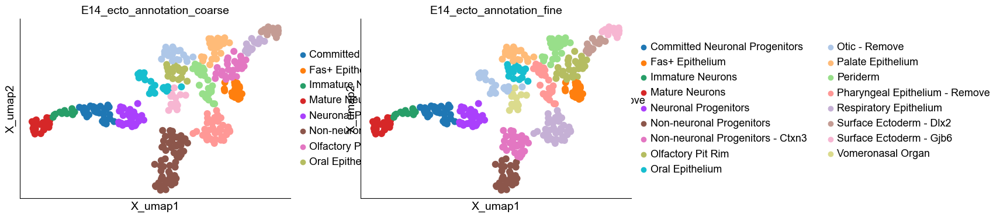

In [70]:
sc.pl.embedding(adata_E14_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['E14_ecto_annotation_coarse','E14_ecto_annotation_fine'],
           ncols=4, cmap=reds, vmin=0.3)

In [71]:
adata_E14_ecto.write('anndata_objects/adata_E14_ecto_annotated.h5ad')

In [ ]:
plot_deg_embedding(adata = adata_E14_ecto, 
                   groupby = 'leiden_default', 
                   cluster_name = '12',
                   n_genes = 250, 
                   method = 'wilcoxon',
                   basis = 'X_umap',)

In [ ]:
# sc.tl.rank_genes_groups(adata_E8, 'leiden', method='wilcoxon', key_added = "wilcoxon")
# sc.pl.rank_genes_groups(adata_E8, key = "wilcoxon")

In [ ]:
# cluster_of_interest = '9'
# reference_cluster = '0'
# sc.set_figure_params(dpi=50,figsize=[6,4])

# sc.tl.rank_genes_groups(adata_E9, 'leiden', groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon')
# sc.pl.rank_genes_groups(adata_E9)
# number_of_genes = 50
# genes = adata_E9.uns['rank_genes_groups']['names'][cluster_of_interest][:number_of_genes].tolist()
# #genes = ['Msx1','Wnt5a','Aopep','Pantr1','Rasl11b','Trps1','Tcf4','Pou3f3','Nfib','Sox11','Aspn','Efna5','Limch1','Fbn2',]
# sc.pl.embedding(
#     adata_E9,
#     basis='X_scvi_MDE',
#     color=['leiden']+genes,
#     frameon=False,
#     ncols=4,
#     cmap = reds,
#     vmin=0.1,
# )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


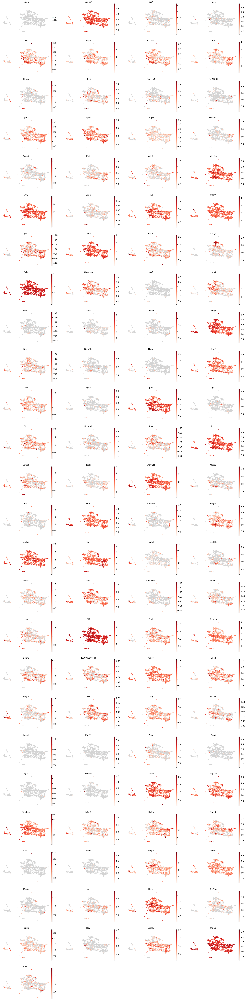

In [7]:
sc.tl.rank_genes_groups(adata_E14, 'leiden', method='wilcoxon', key_added = "wilcoxon")
sc.set_figure_params(dpi=50,figsize=[6,4])

cluster_name = '20'
number_of_genes = 100
genes = adata_E14.uns['wilcoxon']['names'][cluster_name][:number_of_genes].tolist()

sc.pl.embedding(
    adata_E14,
    basis='X_scvi_MDE',
    color=['leiden']+genes,
    frameon=False,
    groups=cluster_name,
    ncols=4,
    cmap = reds,
    vmin=0.1,
)